In [151]:
import os
for dirname, _, filenames in os.walk('datasets'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

datasets\label klasifikasi kecurangan voice.txt
datasets\train\audio\1\1 001.wav
datasets\train\audio\1\1 0010.wav
datasets\train\audio\1\1 00100.wav
datasets\train\audio\1\1 0011.wav
datasets\train\audio\1\1 0012.wav
datasets\train\audio\1\1 0013.wav
datasets\train\audio\1\1 0014.wav
datasets\train\audio\1\1 0015.wav
datasets\train\audio\1\1 0016.wav
datasets\train\audio\1\1 0017.wav
datasets\train\audio\1\1 0018.wav
datasets\train\audio\1\1 0019.wav
datasets\train\audio\1\1 002.wav
datasets\train\audio\1\1 0020.wav
datasets\train\audio\1\1 0021.wav
datasets\train\audio\1\1 0022.wav
datasets\train\audio\1\1 0023.wav
datasets\train\audio\1\1 0024.wav
datasets\train\audio\1\1 0025.wav
datasets\train\audio\1\1 0026.wav
datasets\train\audio\1\1 0027.wav
datasets\train\audio\1\1 0028.wav
datasets\train\audio\1\1 0029.wav
datasets\train\audio\1\1 003.wav
datasets\train\audio\1\1 0030.wav
datasets\train\audio\1\1 0031.wav
datasets\train\audio\1\1 0032.wav
datasets\train\audio\1\1 0033.wav
da

In [152]:
from os.path import isdir, join
from pathlib import Path
import pandas as pd

# Math
import numpy as np
from scipy.fftpack import fft
from scipy import signal
from scipy.io import wavfile
import librosa

from sklearn.decomposition import PCA

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import IPython.display as ipd
import librosa.display

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import pandas as pd

%matplotlib inline

In [153]:
import os
import librosa   #for audio processing
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np
from scipy.io import wavfile #for audio processing
import warnings
warnings.filterwarnings("ignore")

In [154]:
train_audio_path = 'C:/Users/ASUS/Untitled Folder/Sample-TA/datasets/train/audio/'

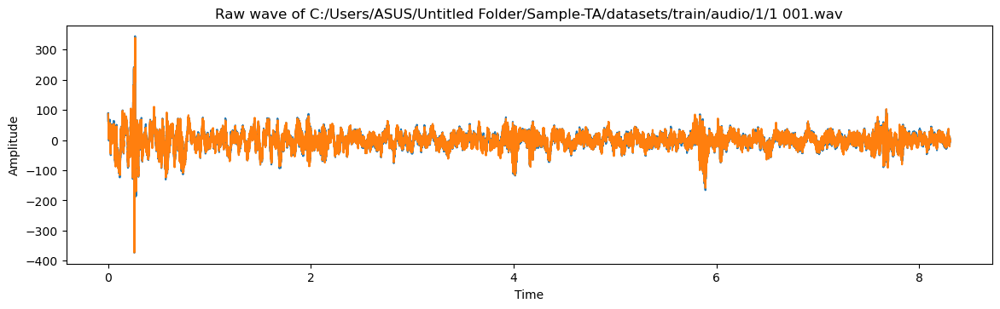

Sample Rate: 44100
Number of Samples: 366107


In [155]:
filename = '1/1 001.wav'
sample_rate, samples = wavfile.read(train_audio_path + filename)
fig = plt.figure(figsize=(14, 8))
ax1 = fig.add_subplot(211)
ax1.set_title('Raw wave of ' + train_audio_path + '1/1 001.wav')
ax1.set_xlabel('Time')
ax1.set_ylabel('Amplitude')
ax1.plot(np.linspace(0, len(samples) / sample_rate, len(samples)), samples)
plt.show()
print('Sample Rate:', sample_rate)
print('Number of Samples:', len(samples))

In [156]:
import soundfile as sf

samples_int16 = samples.astype(np.int16)
sf.write('audio.wav', samples_int16, sample_rate)
ipd.Audio('audio.wav')


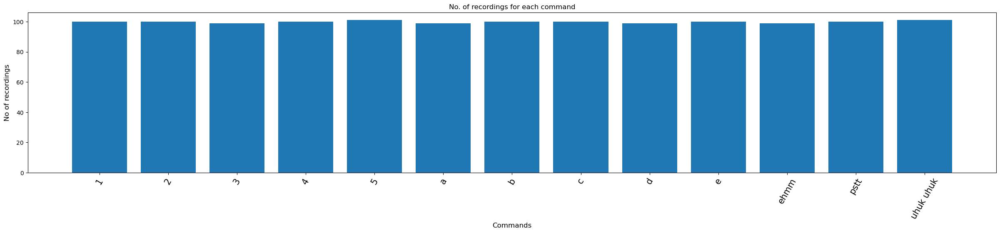

In [157]:
labels=os.listdir(train_audio_path)

#find count of each label and plot bar graph
no_of_recordings=[]
for label in labels:
    waves = [f for f in os.listdir(train_audio_path + '/'+ label) if f.endswith('.wav')]
    no_of_recordings.append(len(waves))
    
#plot
plt.figure(figsize=(30,5))
index = np.arange(len(labels))
plt.bar(index, no_of_recordings)
plt.xlabel('Commands', fontsize=12)
plt.ylabel('No of recordings', fontsize=12)
plt.xticks(index, labels, fontsize=15, rotation=60)
plt.title('No. of recordings for each command')
plt.show()

labels=["1", "2", "3", "4", "5", "a", "b", "c", "d", "e", "uhuk uhuk", "pstt", "ehmm"]

(array([ 10.,  13.,  41., 520., 605.,  94.,   6.,   5.,   2.,   2.]),
 array([ 2.35163265,  3.7381542 ,  5.12467574,  6.51119728,  7.89771882,
         9.28424036, 10.6707619 , 12.05728345, 13.44380499, 14.83032653,
        16.21684807]),
 <BarContainer object of 10 artists>)

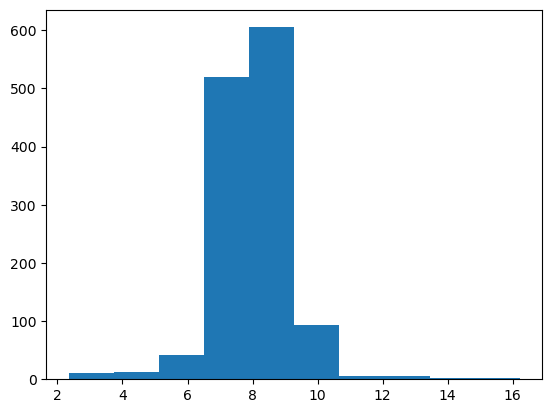

In [132]:
duration_of_recordings=[]
for label in labels:
    waves = [f for f in os.listdir(train_audio_path + "/" +label +"/") if f.endswith('.wav')]
    for wav in waves:
        sample_rate, samples = wavfile.read(train_audio_path + '/' + label + '/' + wav)
        duration_of_recordings.append(float(len(samples)/sample_rate))
    
plt.hist(np.array(duration_of_recordings))

In [ ]:
train_audio_path = 'C:/Users/ASUS/Untitled Folder/Sample-TA/datasets/train/audio'

all_wave = []
all_label = []
desired_length = 8000

for label in labels:
#     print(label)
    waves = [f for f in os.listdir(train_audio_path + '/'+ label) if f.endswith('.wav')]
    for wav in waves:
        samples, sample_rate = librosa.load(train_audio_path + '/' + label + '/' + wav, sr=16000)
        samples = librosa.resample(samples, orig_sr=sample_rate, target_sr=8000)
        all_wave.append(samples)
        all_label.append(label)
        print(all_wave)


[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32)]
[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32)]
[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32)]
[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=floa

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

[array([ 1.5414099e-03,  2.7082432e-03,  2.2624792e-03, ...,
        4.7715061e-05,  3.5465691e-05, -7.0875976e-05], dtype=float32), array([-0.00033087, -0.0005882 , -0.00062259, ..., -0.00010942,
        0.00018611,  0.00013263], dtype=float32), array([-2.5346392e-04, -3.8106862e-04, -2.9374188e-04, ...,
        4.7766953e-05, -7.2243856e-06, -3.3677497e-05], dtype=float32), array([ 1.1308472e-04,  1.3056200e-04,  6.8740184e-05, ...,
       -3.8235431e-04, -3.0206967e-04, -7.6996512e-05], dtype=float32), array([-0.00011062, -0.00037549, -0.00054976, ...,  0.00030248,
        0.0003197 ,  0.00017688], dtype=float32), array([-0.00166653, -0.00296843, -0.00262095, ..., -0.00018659,
        0.00199915, -0.00097693], dtype=float32), array([ 0.00012925,  0.00029513,  0.00030204, ..., -0.00095278,
       -0.00071795,  0.00023054], dtype=float32), array([-1.67337697e-04, -3.30954790e-04, -3.39891412e-04, ...,
        7.66813755e-05,  1.16691866e-04,  1.08911576e-04], dtype=float32), array([ 6

In [ ]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y=le.fit_transform(all_label)
classes= list(le.classes_)
print(classes)

In [ ]:
from keras.utils import np_utils
y=np_utils.to_categorical(y, num_classes=len(labels))

In [ ]:
all_wave = np.array(all_wave).reshape(-1,80000,1)


In [176]:
from sklearn.model_selection import train_test_split

# Memeriksa apakah ada data audio yang dimuat
if len(all_wave) == 0:
    print("Tidak ada data audio yang dimuat. Periksa kembali kode Anda.")
else:
    x_tr, x_val, y_tr, y_val = train_test_split(np.array(all_wave), np.array(all_label), stratify=all_label, test_size=0.2, random_state=777, shuffle=True)

    # Definisikan model dan kompilasi
    model = ...  # Definisikan model Anda di sini
    model.compile(...)

    # Fit model ke data
    history = model.fit(x_tr, y_tr, epochs=100, callbacks=[es, mc], batch_size=32, validation_data=(x_val, y_val))


Tidak ada data audio yang dimuat. Periksa kembali kode Anda.


In [159]:
from keras.layers import Dense, Dropout, Flatten, Conv1D, Input, MaxPooling1D
from keras.models import Model
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K
K.clear_session()

inputs = Input(shape=(8000,1))

#First Conv1D layer
conv = Conv1D(8,13, padding='valid', activation='relu', strides=1)(inputs)
conv = MaxPooling1D(3)(conv)
conv = Dropout(0.2)(conv)

#Second Conv1D layer
conv = Conv1D(16, 11, padding='valid', activation='relu', strides=1)(conv)
conv = MaxPooling1D(3)(conv)
conv = Dropout(0.2)(conv)

#Third Conv1D layer
conv = Conv1D(32, 9, padding='valid', activation='relu', strides=1)(conv)
conv = MaxPooling1D(3)(conv)
conv = Dropout(0.2)(conv)

#Fourth Conv1D layer
conv = Conv1D(64, 7, padding='valid', activation='relu', strides=1)(conv)
conv = MaxPooling1D(3)(conv)
conv = Dropout(0.2)(conv)

#Flatten layer
conv = Flatten()(conv)

#Dense Layer 1
conv = Dense(256, activation='relu')(conv)
conv = Dropout(0.2)(conv)

#Dense Layer 2
conv = Dense(128, activation='relu')(conv)
conv = Dropout(0.2)(conv)

outputs = Dense(len(labels), activation='softmax')(conv)

model = Model(inputs, outputs)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 8000, 1)]         0         
                                                                 
 conv1d (Conv1D)             (None, 7988, 8)           112       
                                                                 
 max_pooling1d (MaxPooling1D  (None, 2662, 8)          0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 2662, 8)           0         
                                                                 
 conv1d_1 (Conv1D)           (None, 2652, 16)          1424      
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 884, 16)          0         
 1D)                                                         

In [160]:
model.compile(loss='categorical_crossentropy',optimizer='sgd',metrics=['accuracy'])

In [161]:
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=10, min_delta=0.00001) 
mc = ModelCheckpoint('best_model.hdf5', monitor='val_acc', verbose=1, save_best_only=True, mode='max')

In [173]:
from sklearn.model_selection import train_test_split

# Memeriksa apakah ada data audio yang dimuat
if len(all_wave) == 0:
    print("Tidak ada data audio yang dimuat. Periksa kembali kode Anda.")
else:
    x_tr, x_val, y_tr, y_val = train_test_split(np.array(all_wave), np.array(all_label), stratify=all_label, test_size=0.2, random_state=777, shuffle=True)

    # Definisikan model dan kompilasi
    model = ...  # Definisikan model Anda di sini
    model.compile(...)

    # Fit model ke data
    history = model.fit(x_tr, y_tr, epochs=100, callbacks=[es, mc], batch_size=32, validation_data=(x_val, y_val))


Tidak ada data audio yang dimuat. Periksa kembali kode Anda.


In [166]:
from matplotlib import pyplot as plt

# Bagi data menjadi data pelatihan (train) dan validasi (val)
x_tr, x_val, y_tr, y_val = train_test_split(np.array(all_wave), np.array(all_label), test_size=0.2, random_state=777, shuffle=True)

# Fit model ke data
history = model.fit(x_tr, y_tr, epochs=100, callbacks=[es, mc], batch_size=32, validation_data=(x_val, y_val))

# Plot loss
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()


ValueError: With n_samples=0, test_size=0.2 and train_size=None, the resulting train set will be empty. Adjust any of the aforementioned parameters.

In [115]:
def predict(audio):
    prob=model.predict(audio.reshape(1,8000,1))
    index=np.argmax(prob[0])
    return classes[index]

In [116]:
import random
index=random.randint(0,len(x_val)-1)
samples=x_val[index].ravel()
print("Audio:",classes[np.argmax(y_val[index])])
ipd.Audio(samples, rate=8000)


NameError: name 'x_val' is not defined

In [117]:
print("Text:",predict(samples))

ValueError: cannot reshape array of size 732214 into shape (1,8000,1)